Copy right: <br>
Under GNU 3.0 License:

Zesheng Jia
B00845993

## Preparation

In [ ]:
import math
from inspect import isfunction
from functools import partial

%matplotlib inline
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
from einops import rearrange
import numpy as np

import torch
from torch import nn, einsum
import torch.nn.functional as F

from PIL import Image
from torchvision.transforms import Compose, ToTensor, Lambda, ToPILImage, CenterCrop, Resize
import requests

import seaborn as sns
sns.set_style("whitegrid", {'axes.grid' : False})
# Set up with a higher resolution screen (useful on Mac)
%config InlineBackend.figure_format = 'retina'

###############################################

## Define the model

I copy the entire building blocks and model structures into this block for builing our model in one code block.


In [ ]:
def epoch_plot(epoch_index):
  # sample 64 images
  # we sample the model from the best models saved
  model_best = Unet(
      dim=image_size,
      channels=channels,
      dim_mults=(1, 2, 4,)
  ).to(device)
  model_best.load_state_dict(torch.load(f"{_exp_name}_best_{epoch_index}.ckpt"))

  samples = sample(model_best, image_size=image_size, batch_size=64, channels=channels)

  fig, axs = plt.subplots(8,8,figsize = (20,20))
  index = 0
  for i in range(8):
    for j in range(8):
      # show a random one
      axs[i][j].imshow(samples[-1][index].reshape(image_size, image_size), cmap="gray")
      index += 1



# function check the item if it exists
def exists(x):
    return x is not None

# if the value exits then return the values
def default(val, d):
    if exists(val):
        return val
    return d() if isfunction(d) else d

# add residual connection
# simply return itself addition with future calculation
class Residual(nn.Module):
    def __init__(self, fn):
        super().__init__()
        self.fn = fn

    def forward(self, x, *args, **kwargs):
        return self.fn(x, *args, **kwargs) + x

# Applies a 2D transposed convolution operator over an input image composed of several input planes'
# kernel size with 4 x 4
# stride size with 2
# padding size with 1
def Upsample(dim):
    return nn.ConvTranspose2d(dim, dim, 4, 2, 1)

# Applies a simple convolution operator
def Downsample(dim):
    return nn.Conv2d(dim, dim, 4, 2, 1)

# Add position Embeddings
class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        # get the current device
        device = time.device
        # we only need half of current dimensions
        half_dim = self.dim // 2

        # Equation of calculating the position embeddings
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        return embeddings

class Block(nn.Module):
    def __init__(self, dim, dim_out, groups = 8):
        super().__init__()
        # Add first layer of 2D Conv
        self.proj = nn.Conv2d(dim, dim_out, 3, padding = 1)
        # Add group Attention
        self.norm = nn.GroupNorm(groups, dim_out)
        # Sigmoid activation function
        self.act = nn.SiLU()

    def forward(self, x, scale_shift = None):
        x = self.proj(x)
        x = self.norm(x)

        if exists(scale_shift):
            scale, shift = scale_shift
            x = x * (scale + 1) + shift

        x = self.act(x)
        return x


# Add Resnet Block
# The activation function we choose is sigmoid function
# Applies the Sigmoid Linear Unit (SiLU) function

class ResnetBlock(nn.Module):
    """https://arxiv.org/abs/1512.03385"""

    def __init__(self, dim, dim_out, *, time_emb_dim=None, groups=8):
        super().__init__()
        self.mlp = (
            nn.Sequential(nn.SiLU(), nn.Linear(time_emb_dim, dim_out))
            if exists(time_emb_dim)
            else None
        )

        self.block1 = Block(dim, dim_out, groups=groups)
        self.block2 = Block(dim_out, dim_out, groups=groups)
        self.res_conv = nn.Conv2d(dim, dim_out, 1) if dim != dim_out else nn.Identity()

    def forward(self, x, time_emb=None):
        h = self.block1(x)

        # here we use einops package for re-arrange dimensions
        # einops.rearrange is a reader-friendly smart element reordering for multidimensional tensors.
        # This operation includes functionality of transpose (axes permutation), reshape (view),
        # squeeze, unsqueeze, stack, concatenate and other operations.

        if exists(self.mlp) and exists(time_emb):
            # we add 1 multi-layer perceptron
            time_emb = self.mlp(time_emb)
            # we add 2 extra dimensions from batch and channel to
            # 4 dimension tensor (batch, channel, 1, 1 )
            h = rearrange(time_emb, "b c -> b c 1 1") + h

        h = self.block2(h)
        return h + self.res_conv(x)


# There is one extra model we defined. That is ConvNext model
# GELU for Gaussian Error Linear Units function:

class ConvNextBlock(nn.Module):
    """https://arxiv.org/abs/2201.03545"""

    def __init__(self, dim, dim_out, *, time_emb_dim=None, mult=2, norm=True):
        super().__init__()
        self.mlp = (
            # We use Gaussian Error Linear Units function:
            nn.Sequential(nn.GELU(), nn.Linear(time_emb_dim, dim))
            if exists(time_emb_dim)
            else None
        )

        self.ds_conv = nn.Conv2d(dim, dim, 7, padding=3, groups=dim)

        self.net = nn.Sequential(
            nn.GroupNorm(1, dim) if norm else nn.Identity(),
            nn.Conv2d(dim, dim_out * mult, 3, padding=1),
            nn.GELU(),
            nn.GroupNorm(1, dim_out * mult),
            nn.Conv2d(dim_out * mult, dim_out, 3, padding=1),
        )

        self.res_conv = nn.Conv2d(dim, dim_out, 1) if dim != dim_out else nn.Identity()

    def forward(self, x, time_emb=None):
        h = self.ds_conv(x)

        if exists(self.mlp) and exists(time_emb):
            assert exists(time_emb), "time embedding must be passed in"
            condition = self.mlp(time_emb)
            h = h + rearrange(condition, "b c -> b c 1 1")

        h = self.net(h)
        return h + self.res_conv(x)

class Attention(nn.Module):
    def __init__(self, dim, heads=4, dim_head=32):
        super().__init__()

        # Get attention heads and dimensions
        self.scale = dim_head**-0.5
        self.heads = heads
        hidden_dim = dim_head * heads

        # separate one parameter matrix to 3 matrix as query, key, and value
        self.to_qkv = nn.Conv2d(dim, hidden_dim * 3, 1, bias=False)
        # output dimension (Hidden_dim, dim, 1)
        self.to_out = nn.Conv2d(hidden_dim, dim, 1)

    def forward(self, x):

        # b for batch size
        # c for channel
        # h for height
        # w for weight
        b, c, h, w = x.shape

        # concatenate q,k,v together
        qkv = self.to_qkv(x).chunk(3, dim=1)

        # rearrange qkv's dimension
        q, k, v = map(
            lambda t: rearrange(t, "b (h c) x y -> b h c (x y)", h=self.heads), qkv
        )

        # calculating the attention score:

        q = q * self.scale

        sim = einsum("b h d i, b h d j -> b h i j", q, k)
        sim = sim - sim.amax(dim=-1, keepdim=True).detach()
        attn = sim.softmax(dim=-1)

        out = einsum("b h i j, b h d j -> b h i d", attn, v)
        out = rearrange(out, "b h (x y) d -> b (h d) x y", x=h, y=w)


        return self.to_out(out)


class LinearAttention(nn.Module):
    def __init__(self, dim, heads=4, dim_head=32):
        super().__init__()
        self.scale = dim_head**-0.5
        self.heads = heads
        hidden_dim = dim_head * heads
        self.to_qkv = nn.Conv2d(dim, hidden_dim * 3, 1, bias=False)

        self.to_out = nn.Sequential(nn.Conv2d(hidden_dim, dim, 1),
                                    nn.GroupNorm(1, dim))

    def forward(self, x):
        b, c, h, w = x.shape
        qkv = self.to_qkv(x).chunk(3, dim=1)
        q, k, v = map(
            lambda t: rearrange(t, "b (h c) x y -> b h c (x y)", h=self.heads), qkv
        )

        q = q.softmax(dim=-2)
        k = k.softmax(dim=-1)

        q = q * self.scale
        context = torch.einsum("b h d n, b h e n -> b h d e", k, v)

        out = torch.einsum("b h d e, b h d n -> b h e n", context, q)
        out = rearrange(out, "b h c (x y) -> b (h c) x y", h=self.heads, x=h, y=w)
        return self.to_out(out)


class PreNorm(nn.Module):
    def __init__(self, dim, fn):
        super().__init__()
        self.fn = fn
        self.norm = nn.GroupNorm(1, dim)

    def forward(self, x):
        x = self.norm(x)
        return self.fn(x)        


class Unet(nn.Module):
    def __init__(
        self,
        dim,
        init_dim=None,
        out_dim=None,
        dim_mults=(1, 2, 4, 8),
        channels=3,
        with_time_emb=True,
        resnet_block_groups=8,
        use_convnext=True,
        convnext_mult=2,
    ):
        super().__init__()

        # determine dimensions
        self.channels = channels

        init_dim = default(init_dim, dim // 3 * 2)
        self.init_conv = nn.Conv2d(channels, init_dim, 7, padding=3)

        dims = [init_dim, *map(lambda m: dim * m, dim_mults)]
        in_out = list(zip(dims[:-1], dims[1:]))

        if use_convnext:
            block_klass = partial(ConvNextBlock, mult=convnext_mult)
        else:
            block_klass = partial(ResnetBlock, groups=resnet_block_groups)

        # time embeddings
        if with_time_emb:
            time_dim = dim * 4
            self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(dim),
                nn.Linear(dim, time_dim),
                nn.GELU(),
                nn.Linear(time_dim, time_dim),
            )
        else:
            time_dim = None
            self.time_mlp = None

        # layers
        self.downs = nn.ModuleList([])
        self.ups = nn.ModuleList([])
        num_resolutions = len(in_out)

        for ind, (dim_in, dim_out) in enumerate(in_out):
            is_last = ind >= (num_resolutions - 1)

            self.downs.append(
                nn.ModuleList(
                    [
                        block_klass(dim_in, dim_out, time_emb_dim=time_dim),
                        block_klass(dim_out, dim_out, time_emb_dim=time_dim),
                        Residual(PreNorm(dim_out, LinearAttention(dim_out))),
                        Downsample(dim_out) if not is_last else nn.Identity(),
                    ]
                )
            )

        mid_dim = dims[-1]
        self.mid_block1 = block_klass(mid_dim, mid_dim, time_emb_dim=time_dim)
        self.mid_attn = Residual(PreNorm(mid_dim, Attention(mid_dim)))
        self.mid_block2 = block_klass(mid_dim, mid_dim, time_emb_dim=time_dim)

        for ind, (dim_in, dim_out) in enumerate(reversed(in_out[1:])):
            is_last = ind >= (num_resolutions - 1)

            self.ups.append(
                nn.ModuleList(
                    [
                        block_klass(dim_out * 2, dim_in, time_emb_dim=time_dim),
                        block_klass(dim_in, dim_in, time_emb_dim=time_dim),
                        Residual(PreNorm(dim_in, LinearAttention(dim_in))),
                        Upsample(dim_in) if not is_last else nn.Identity(),
                    ]
                )
            )

        out_dim = default(out_dim, channels)
        self.final_conv = nn.Sequential(
            block_klass(dim, dim), nn.Conv2d(dim, out_dim, 1)
        )

    def forward(self, x, time):
        x = self.init_conv(x)

        t = self.time_mlp(time) if exists(self.time_mlp) else None

        h = []

        # downsample
        for block1, block2, attn, downsample in self.downs:
            x = block1(x, t)
            x = block2(x, t)
            x = attn(x)
            h.append(x)
            x = downsample(x)

        # bottleneck
        x = self.mid_block1(x, t)
        x = self.mid_attn(x)
        x = self.mid_block2(x, t)

        # upsample
        for block1, block2, attn, upsample in self.ups:
            x = torch.cat((x, h.pop()), dim=1)
            x = block1(x, t)
            x = block2(x, t)
            x = attn(x)
            x = upsample(x)

        return self.final_conv(x)

def cosine_beta_schedule(timesteps, s=0.008):
    """
    cosine schedule as proposed in https://arxiv.org/abs/2102.09672
    """
    steps = timesteps + 1
    x = torch.linspace(0, timesteps, steps)
    alphas_cumprod = torch.cos(((x / timesteps) + s) / (1 + s) * torch.pi * 0.5) ** 2
    alphas_cumprod = alphas_cumprod / alphas_cumprod[0]
    betas = 1 - (alphas_cumprod[1:] / alphas_cumprod[:-1])
    return torch.clip(betas, 0.0001, 0.9999)

def linear_beta_schedule(timesteps):
    beta_start = 0.0001
    beta_end = 0.02
    return torch.linspace(beta_start, beta_end, timesteps)

def quadratic_beta_schedule(timesteps):
    beta_start = 0.0001
    beta_end = 0.02
    return torch.linspace(beta_start**0.5, beta_end**0.5, timesteps) ** 2

def sigmoid_beta_schedule(timesteps):
    beta_start = 0.0001
    beta_end = 0.02
    betas = torch.linspace(-6, 6, timesteps)
    return torch.sigmoid(betas) * (beta_end - beta_start) + beta_start


timesteps = 300

# define beta schedule
betas = linear_beta_schedule(timesteps=timesteps)

# define alphas 
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)

# calculations for diffusion q(x_t | x_{t-1}) and others
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)

# calculations for posterior q(x_{t-1} | x_t, x_0)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

def extract(a, t, x_shape):
    batch_size = t.shape[0]
    out = a.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)


# forward diffusion
def q_sample(x_start, t, noise=None):
    if noise is None:
        noise = torch.randn_like(x_start)

    sqrt_alphas_cumprod_t = extract(sqrt_alphas_cumprod, t, x_start.shape)
    sqrt_one_minus_alphas_cumprod_t = extract(
        sqrt_one_minus_alphas_cumprod, t, x_start.shape
    )

    return sqrt_alphas_cumprod_t * x_start + sqrt_one_minus_alphas_cumprod_t * noise


def get_noisy_image(x_start, t):
  # add noise
  x_noisy = q_sample(x_start, t=t)

  # turn back into PIL image
  noisy_image = reverse_transform(x_noisy.squeeze())

  return noisy_image

def p_losses(denoise_model, x_start, t, noise=None, loss_type="l1"):
    if noise is None:
        noise = torch.randn_like(x_start)

    x_noisy = q_sample(x_start=x_start, t=t, noise=noise)
    predicted_noise = denoise_model(x_noisy, t)

    if loss_type == 'l1':
        loss = F.l1_loss(noise, predicted_noise)
    elif loss_type == 'l2':
        loss = F.mse_loss(noise, predicted_noise)
    elif loss_type == "huber":
        loss = F.smooth_l1_loss(noise, predicted_noise)
    else:
        raise NotImplementedError()

    return loss

from datasets import load_dataset
dataset = load_dataset("imagefolder", data_dir="F:/academic/2022/DIffusion/Diffusion_project/dataset")
# dataset = load_dataset("fashion_mnist")

from torchvision import transforms
from torch.utils.data import DataLoader

image_size = 44
channels = 1
batch_size = 80


# define image transformations (e.g. using torchvision)
transform = Compose([
            Resize(image_size),
            CenterCrop(image_size),
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),
            transforms.Lambda(lambda t: (t * 2) - 1)
])

# define function
def transforms(examples):
   examples["pixel_values"] = [transform(image.convert("L")) for image in examples["image"]]
   del examples["image"]

   return examples

transformed_dataset = dataset.with_transform(transforms).remove_columns("label")

# create dataloader
dataloader = DataLoader(transformed_dataset["train"], batch_size=batch_size, shuffle=True)

batch = next(iter(dataloader))
print(batch.keys())

@torch.no_grad()
def p_sample(model, x, t, t_index):
    betas_t = extract(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = extract(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = extract(sqrt_recip_alphas, t, x.shape)
    
    # Equation 11 in the paper
    # Use our model (noise predictor) to predict the mean
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )

    if t_index == 0:
        return model_mean
    else:
        posterior_variance_t = extract(posterior_variance, t, x.shape)
        noise = torch.randn_like(x)
        # Algorithm 2 line 4:
        return model_mean + torch.sqrt(posterior_variance_t) * noise 

# Algorithm 2 but save all images:
@torch.no_grad()
def p_sample_loop(model, shape):
    device = next(model.parameters()).device

    b = shape[0]
    # start from pure noise (for each example in the batch)
    img = torch.randn(shape, device=device)
    imgs = []
    
    for i in tqdm(reversed(range(0, timesteps)), desc='sampling loop time step', total=timesteps):
        img = p_sample(model, img, torch.full((b,), i, device=device, dtype=torch.long), i)
        imgs.append(img.cpu().numpy())
    return imgs

@torch.no_grad()
def sample(model, image_size, batch_size=16, channels=3):
    return p_sample_loop(model, shape=(batch_size, channels, image_size, image_size))


from torch.optim import Adam

device = "cuda" if torch.cuda.is_available() else "cpu"

model = Unet(
    dim=image_size,
    channels=channels,
    dim_mults=(1, 2, 4,)
)
model.to(device)

optimizer = Adam(model.parameters(), lr=1e-3)









Resolving data files:   0%|          | 0/3264 [00:00<?, ?it/s]

Using custom data configuration default-5501923bb35f5511
Found cached dataset imagefolder (C:/Users/zesheng_jia/.cache/huggingface/datasets/imagefolder/default-5501923bb35f5511/0.0.0/37fbb85cc714a338bea574ac6c7d0b5be5aff46c1862c1989b20e0771199e93f)


  0%|          | 0/1 [00:00<?, ?it/s]

dict_keys(['pixel_values'])


## Inference

In [ ]:
_exp_name = "models"
image_size = 44

In [ ]:
# sample 64 images
# we sample the model from the best models saved
model_best = Unet(
    dim=image_size,
    channels=channels,
    dim_mults=(1, 2, 4,)
).to(device)
model_best.load_state_dict(torch.load(f"{_exp_name}_best.ckpt"))

samples = sample(model_best, image_size=image_size, batch_size=64, channels=channels)

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

In [ ]:
# sample 64 images
# we sample the model from the best models saved
model_best = Unet(
    dim=image_size,
    channels=channels,
    dim_mults=(1, 2, 4,)
).to(device)
model_best.load_state_dict(torch.load(f"{_exp_name}_best.ckpt"))

samples = sample(model_best, image_size=image_size, batch_size=64, channels=channels)

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

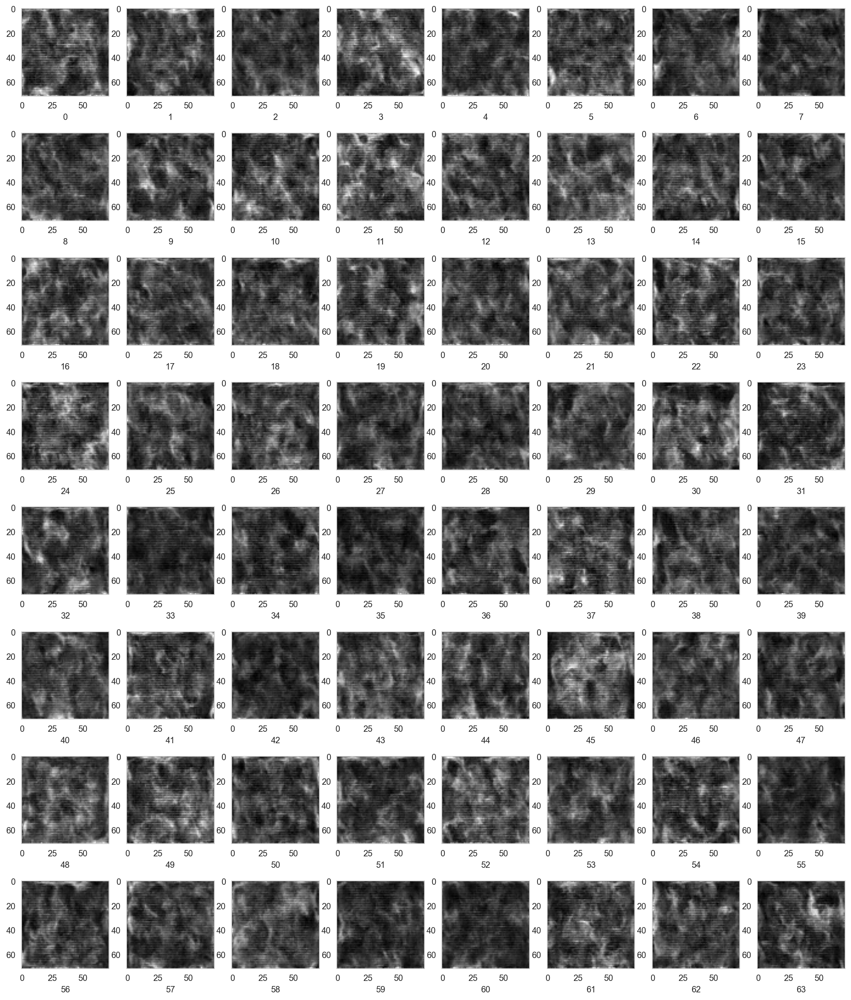

In [ ]:
fig, axs = plt.subplots(8,8,figsize = (20,20))
plt.subplots_adjust(bottom=0.1, right=0.8, top=0.9)
index = 0
for i in range(8):
  for j in range(8):
     # show a random one
    axs[i][j].imshow(samples[-1][index].reshape(image_size, image_size), cmap="gray")
    axs[i][j].set_xlabel(str(index))
    index += 1

### 1. Best Model

First one is the best model we have so far.

In [ ]:
_exp_name = "models"

In [ ]:
# sample 64 images
# we sample the model from the best models saved
model_best = Unet(
    dim=image_size,
    channels=channels,
    dim_mults=(1, 2, 4,)
).to(device)
model_best.load_state_dict(torch.load(f"{_exp_name}_best.ckpt"))

samples = sample(model_best, image_size=image_size, batch_size=64, channels=channels)

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

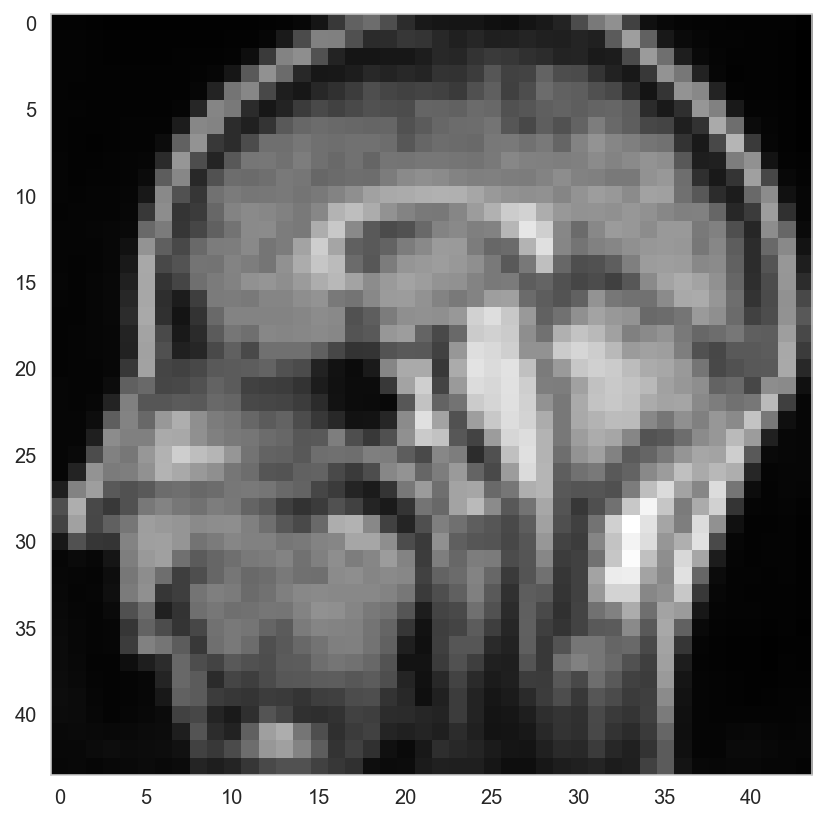

In [ ]:
# show a random one
fig, axs = plt.subplots(figsize = (7,7))
random_index = 62
axs.imshow(samples[-1][random_index].reshape(image_size, image_size), cmap="gray")

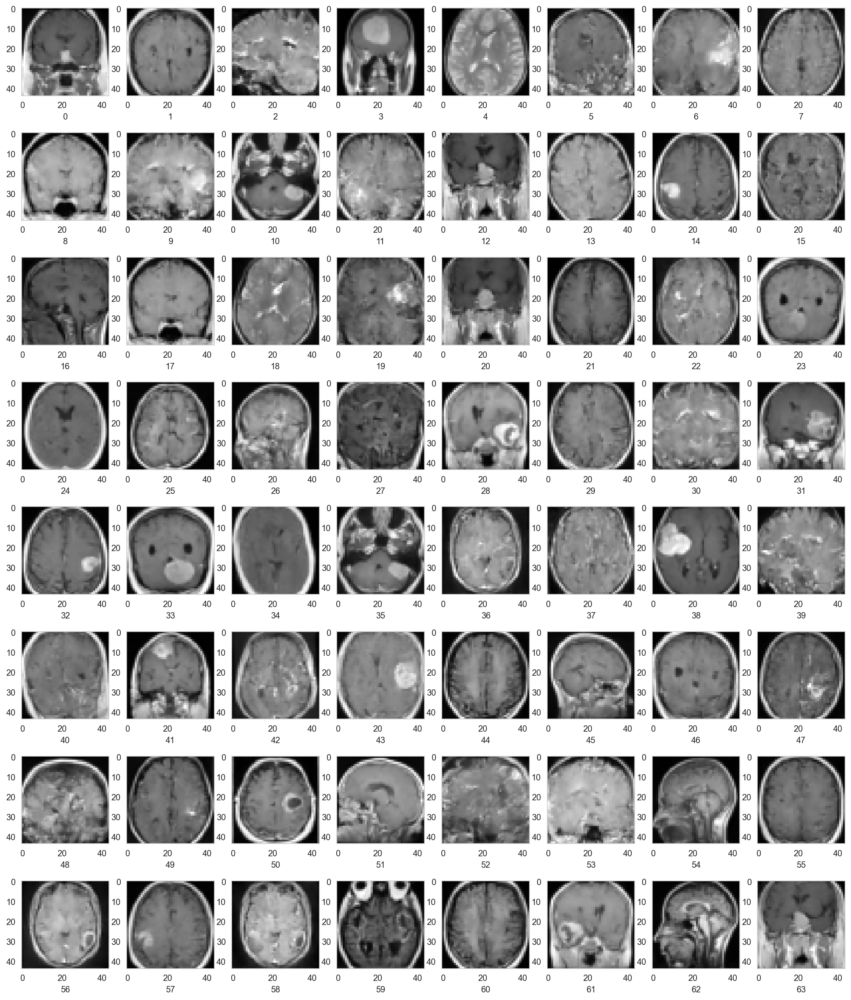

In [ ]:
fig, axs = plt.subplots(8,8,figsize = (20,20))
plt.subplots_adjust(bottom=0.1, right=0.8, top=0.9)
index = 0
for i in range(8):
  for j in range(8):
     # show a random one
    axs[i][j].imshow(samples[-1][index].reshape(image_size, image_size), cmap="gray")
    axs[i][j].set_xlabel(str(index))
    index += 1

MovieWriter ffmpeg unavailable; using Pillow instead.


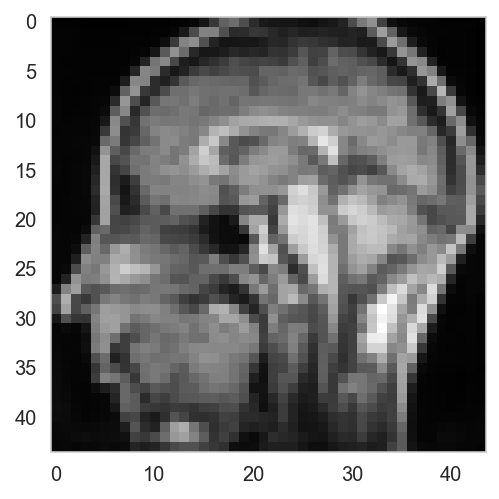

In [ ]:
import matplotlib.animation as animation

random_index = 62

fig = plt.figure()
ims = []
for i in range(timesteps):
    im = plt.imshow(samples[i][random_index].reshape(image_size, image_size), cmap="gray", animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)
ani.save('dynamic_images.gif')
plt.show()

In [ ]:
# sample 64 images
# we sample the model from the best models saved

image_size = 128

model_best = Unet(
    dim=image_size,
    channels=channels,
    dim_mults=(1, 2, 4,)
).to(device)
model_best.load_state_dict(torch.load(f"{_exp_name}_best.ckpt"))

samples = sample(model_best, image_size=image_size, batch_size=64, channels=channels)

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

In [ ]:
import joblib
joblib.dump(samples, 'sample.pkl') 

['sample.pkl']

## newest Best

In [ ]:
# sample 64 images
# we sample the model from the best models saved

model_best = Unet(
    dim=image_size,
    channels=channels,
    dim_mults=(1, 2, 4,)
).to(device)

model_best.load_state_dict(torch.load(f"{_exp_name}_temp.ckpt"))

samples = sample(model_best, image_size=image_size, batch_size=64, channels=channels)

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

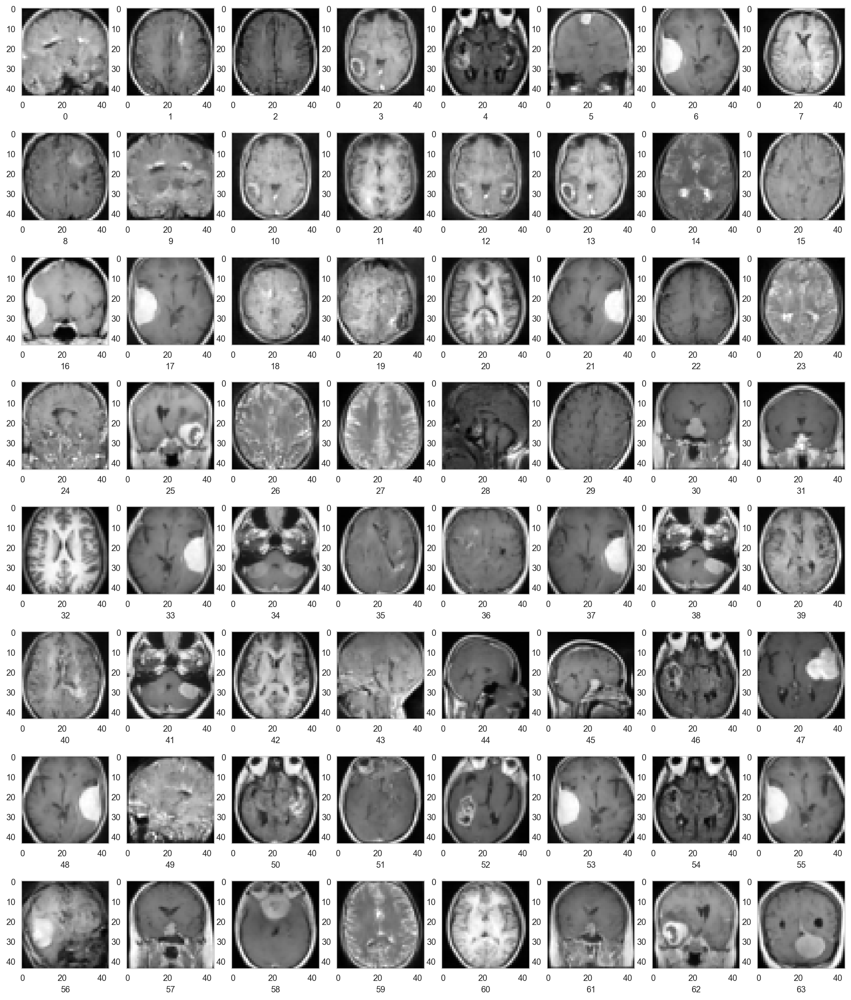

In [ ]:
fig, axs = plt.subplots(8,8,figsize = (20,20))
plt.subplots_adjust(bottom=0.1, right=0.8, top=0.9)
index = 0
for i in range(8):
  for j in range(8):
     # show a random one
    axs[i][j].imshow(samples[-1][index].reshape(image_size, image_size), cmap="gray")
    axs[i][j].set_xlabel(str(index))
    index += 1

## Improving Demonstration

In [ ]:
def epoch_plot(epoch_index):
  # sample 64 images
  # we sample the model from the best models saved
  model_best = Unet(
      dim=image_size,
      channels=channels,
      dim_mults=(1, 2, 4,)
  ).to(device)
  model_best.load_state_dict(torch.load(f"{_exp_name}_best_{epoch_index}.ckpt"))

  samples = sample(model_best, image_size=image_size, batch_size=64, channels=channels)

  fig, axs = plt.subplots(8,8,figsize = (20,20))
  index = 0
  for i in range(8):
    for j in range(8):
      # show a random one
      axs[i][j].imshow(samples[-1][index].reshape(image_size, image_size), cmap="gray")
      index += 1

### epoch 0

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

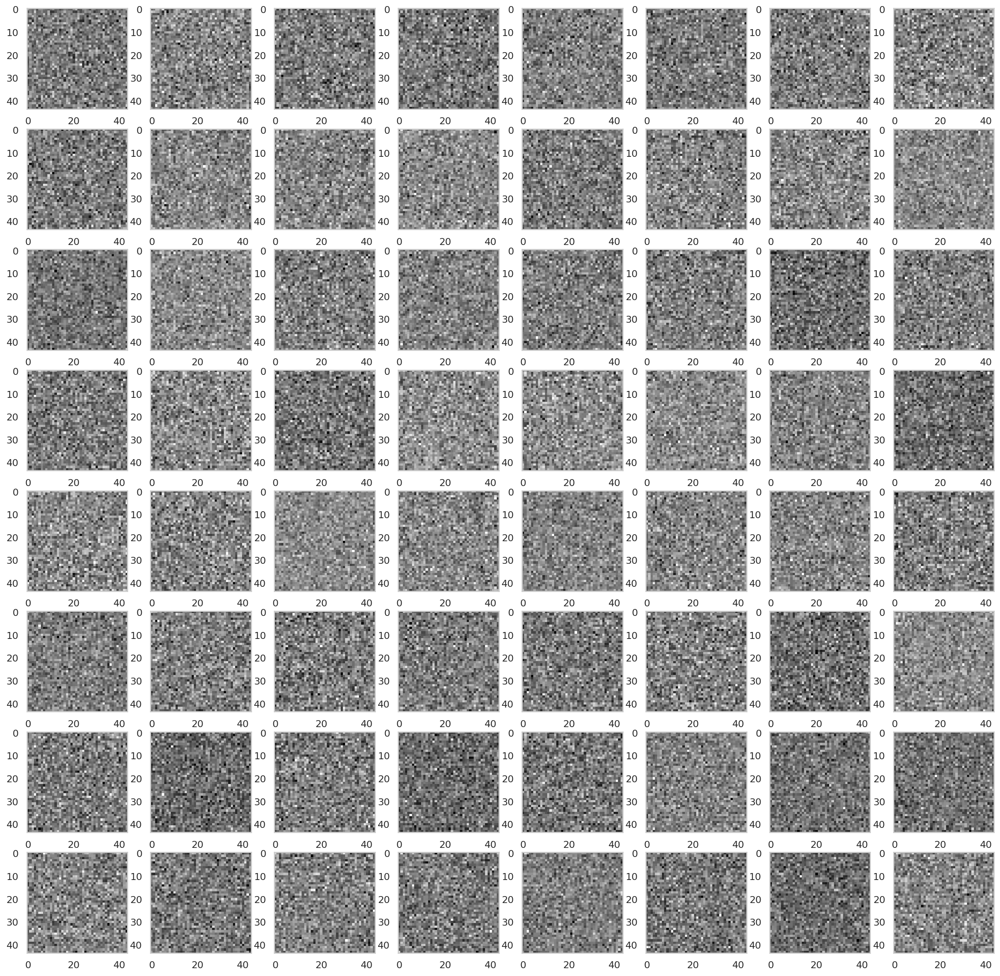

In [ ]:
epoch_plot(0)

### epoch 15

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

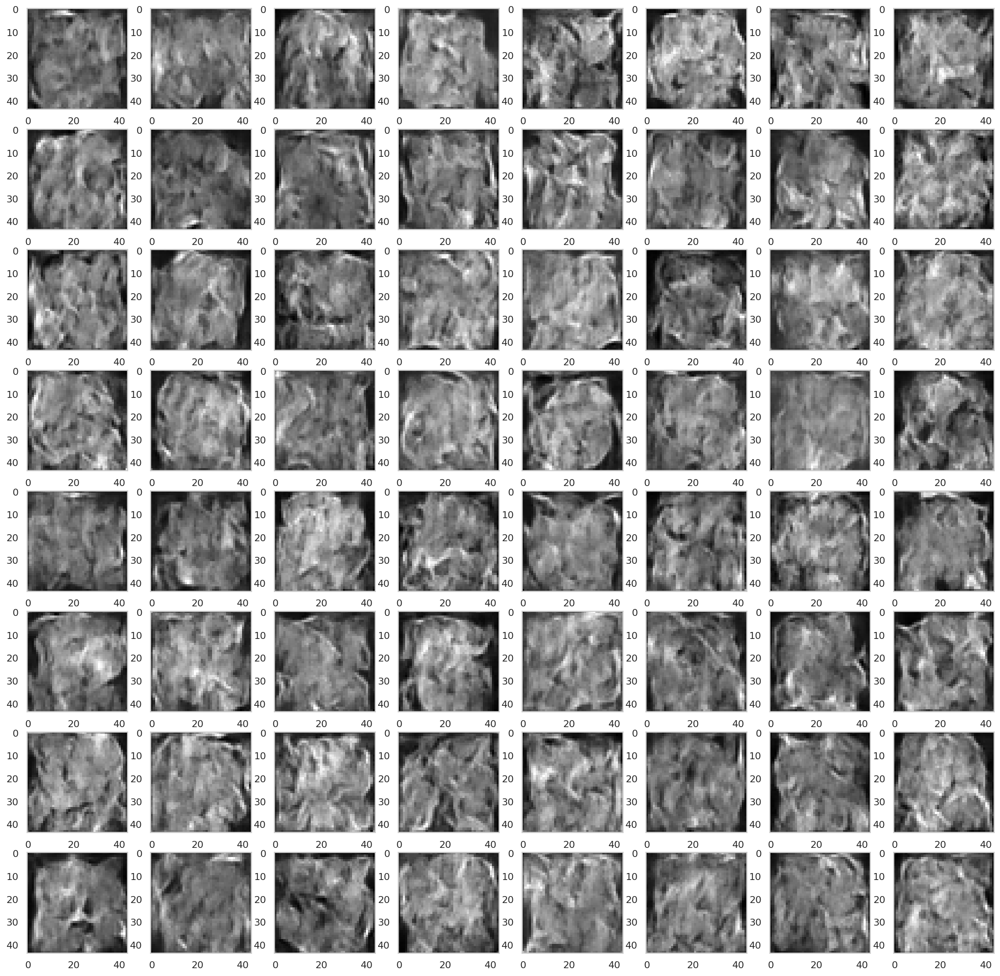

In [ ]:
epoch_plot(15)

### epoch 30

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

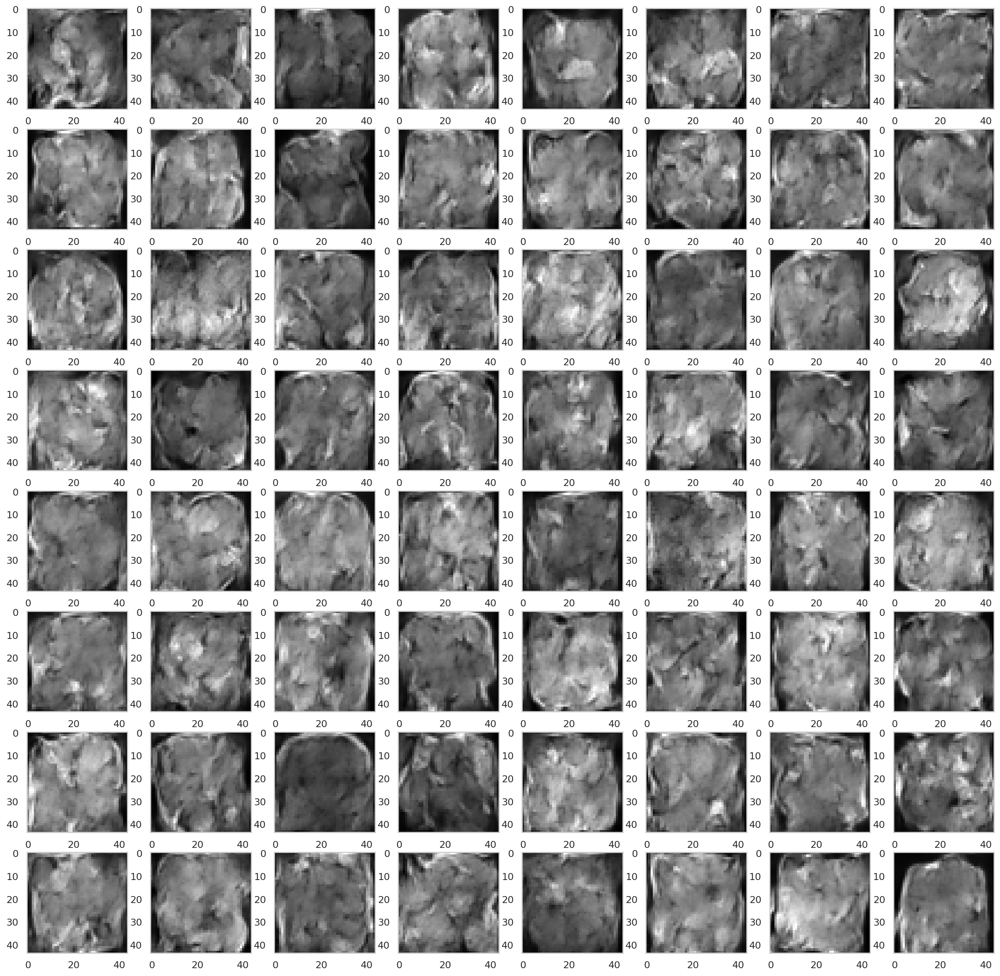

In [ ]:
epoch_plot(30)

### epoch 45

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

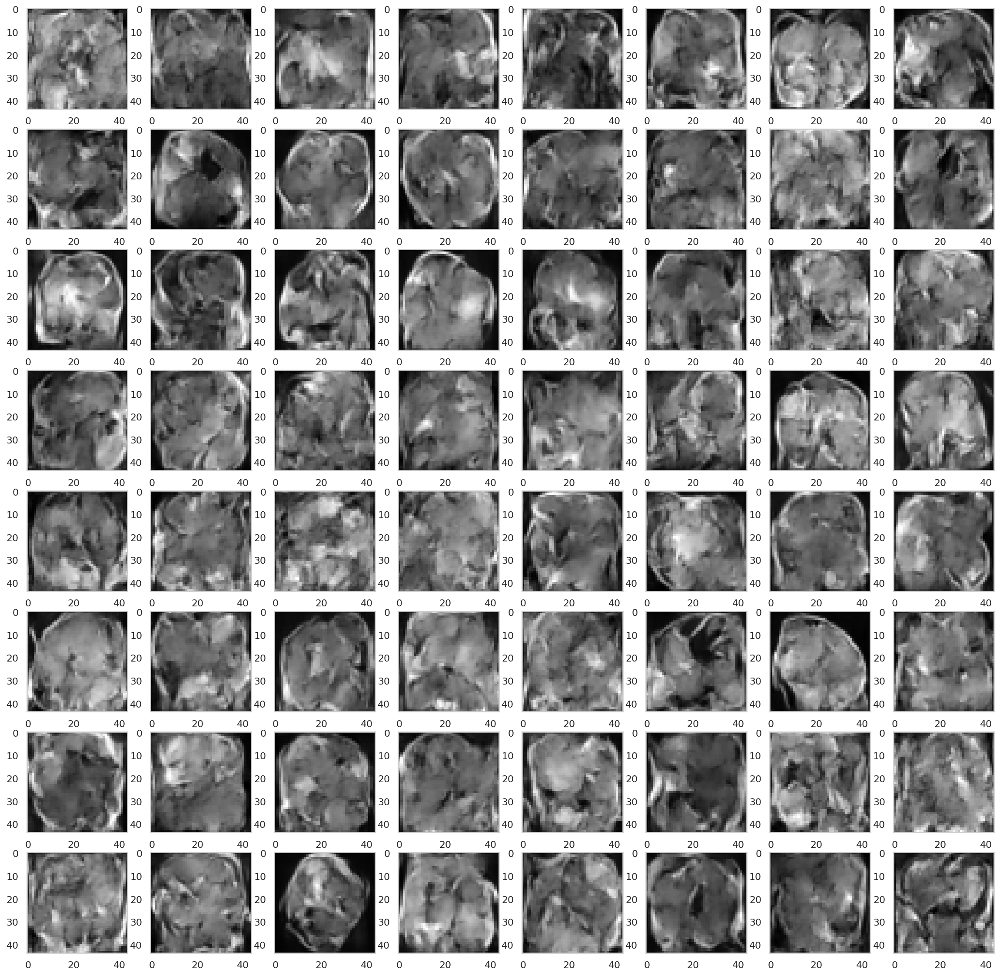

In [ ]:
epoch_plot(45)

### epoch 75

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

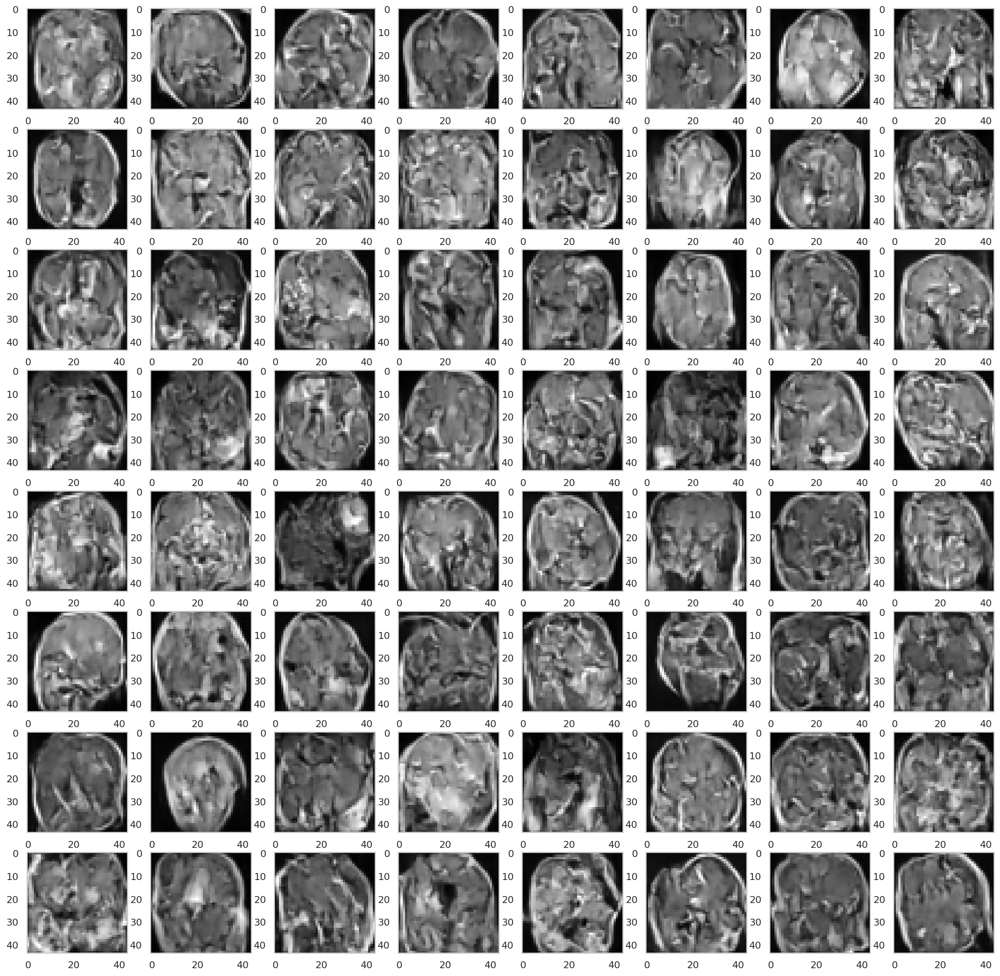

In [ ]:
epoch_plot(75)

### epoch 90

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

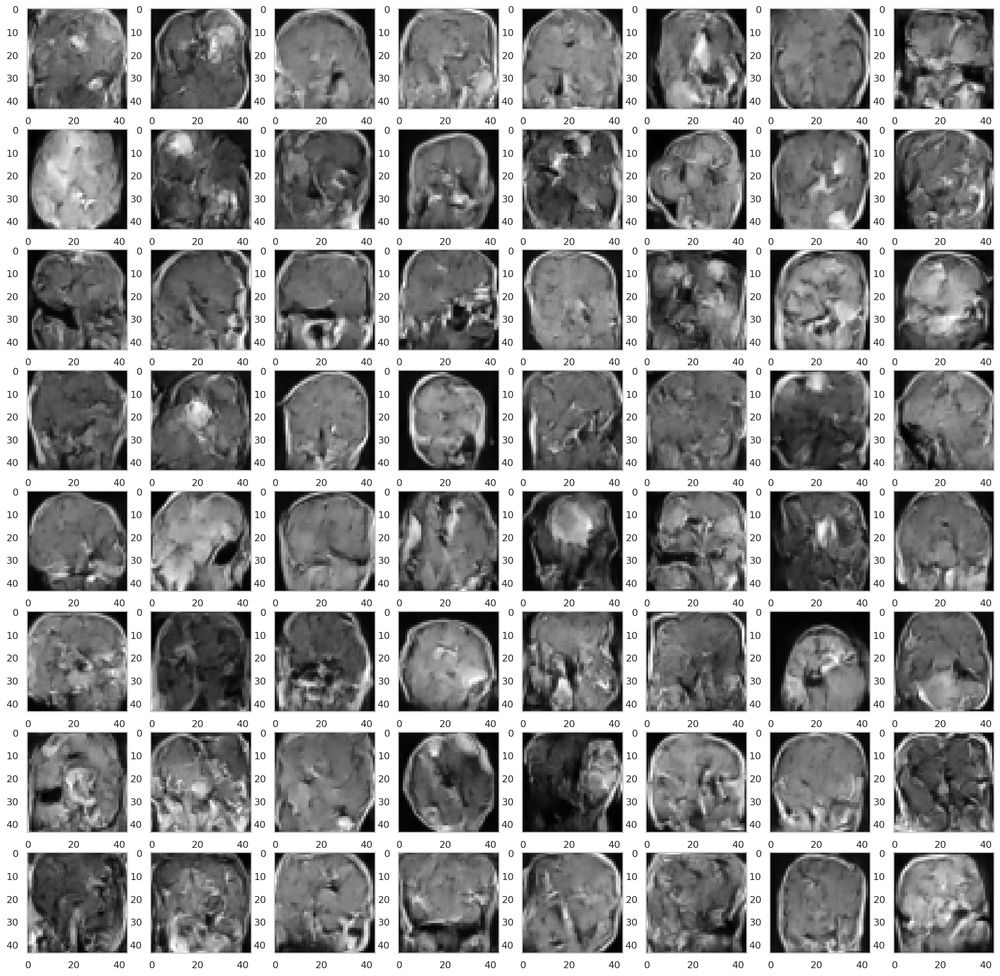

In [ ]:
epoch_plot(90)

### epoch 105


sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

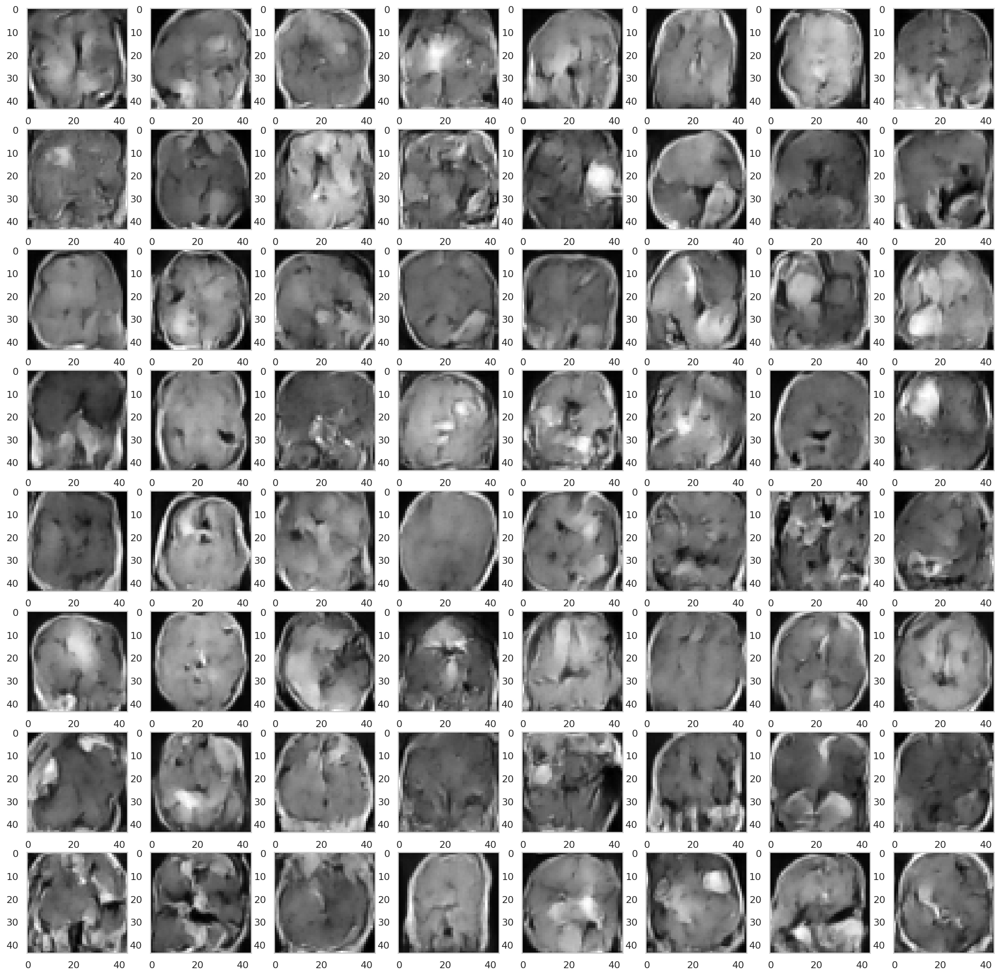

In [ ]:
epoch_plot(105)

### epoch 120


sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

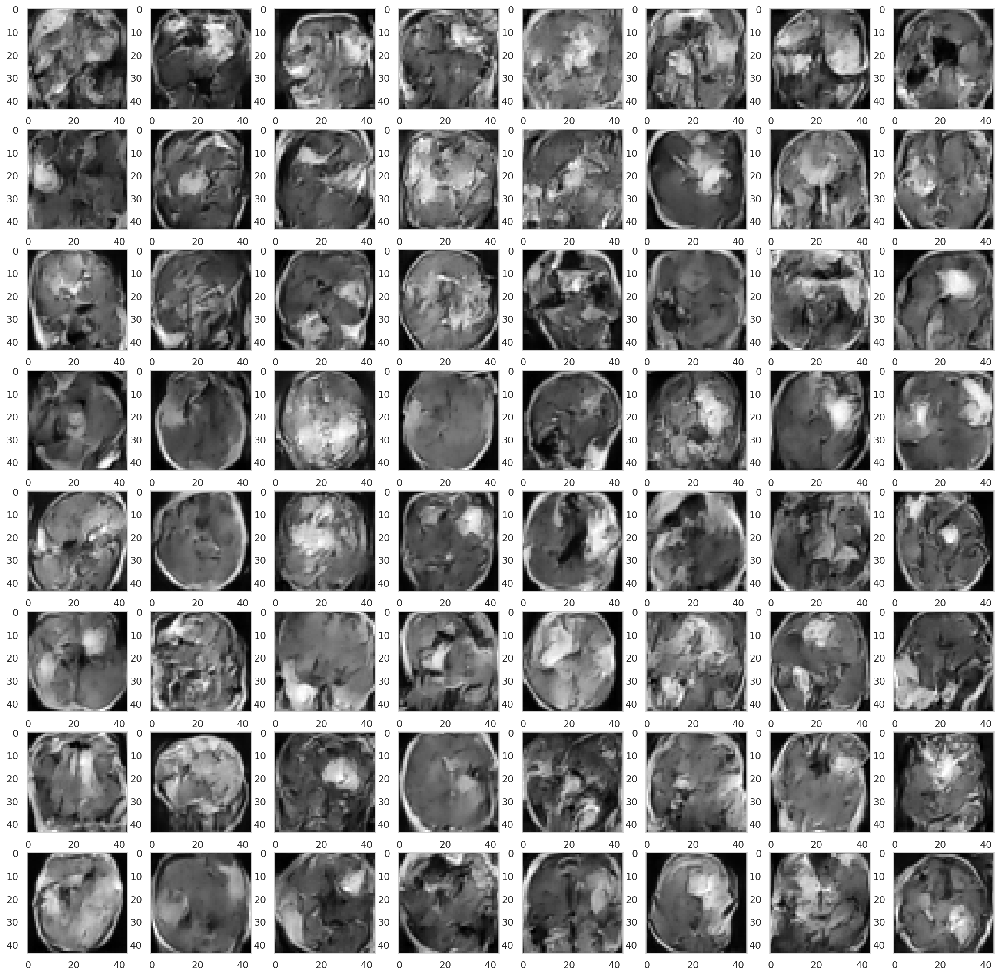

In [ ]:
epoch_plot(120)

### epoch 135


sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

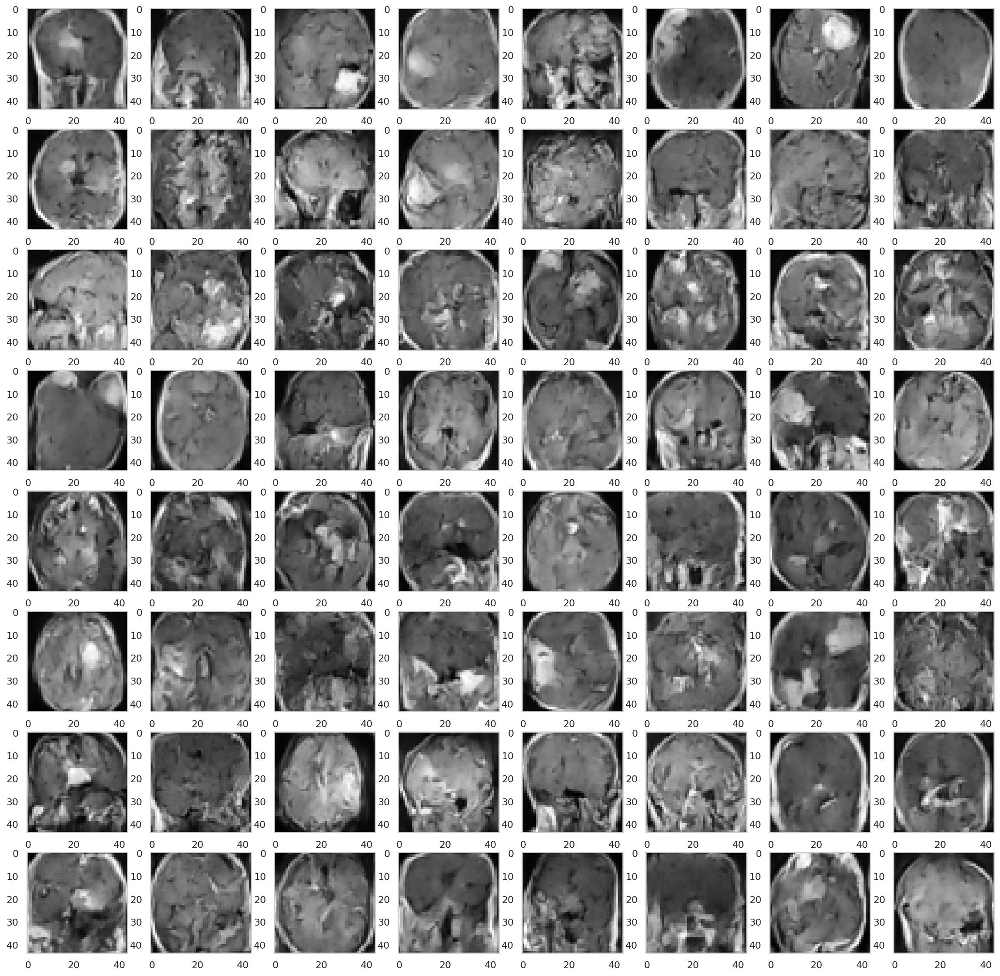

In [ ]:
epoch_plot(135)

### epoch 150

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

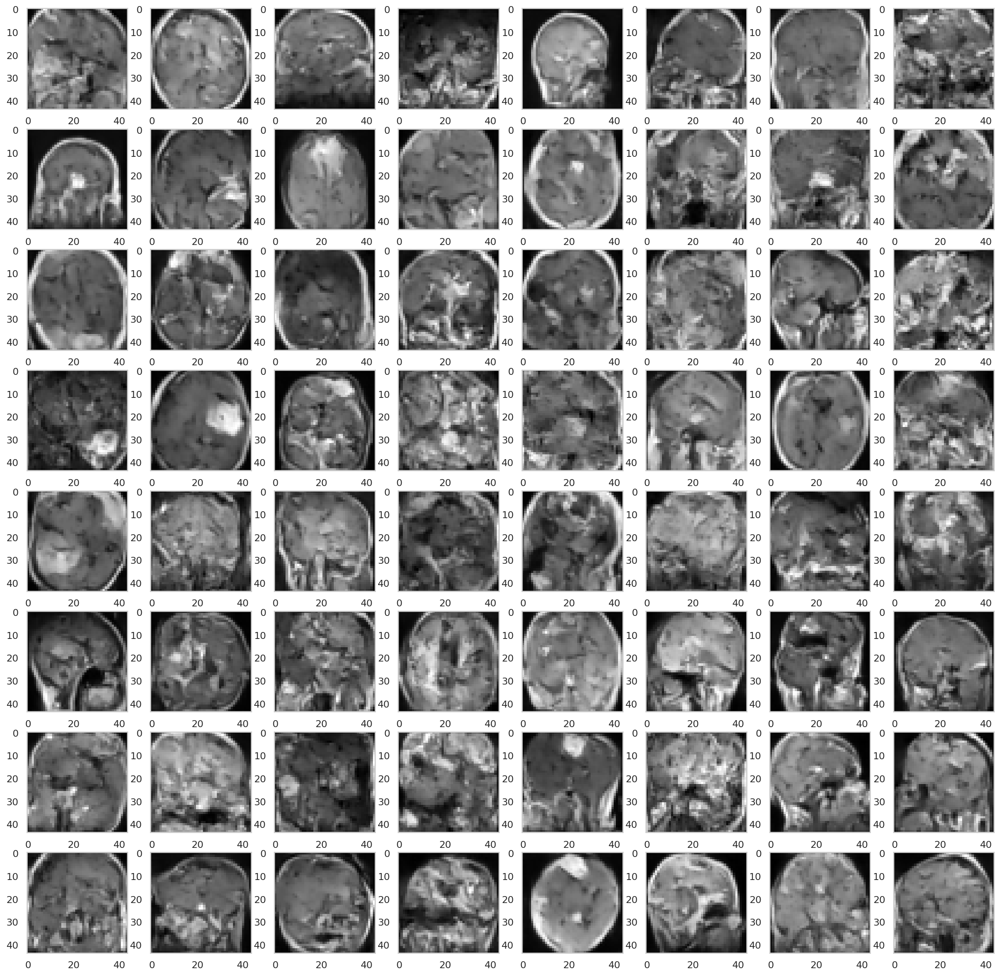

In [ ]:
epoch_plot(150)

### epoch 165

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

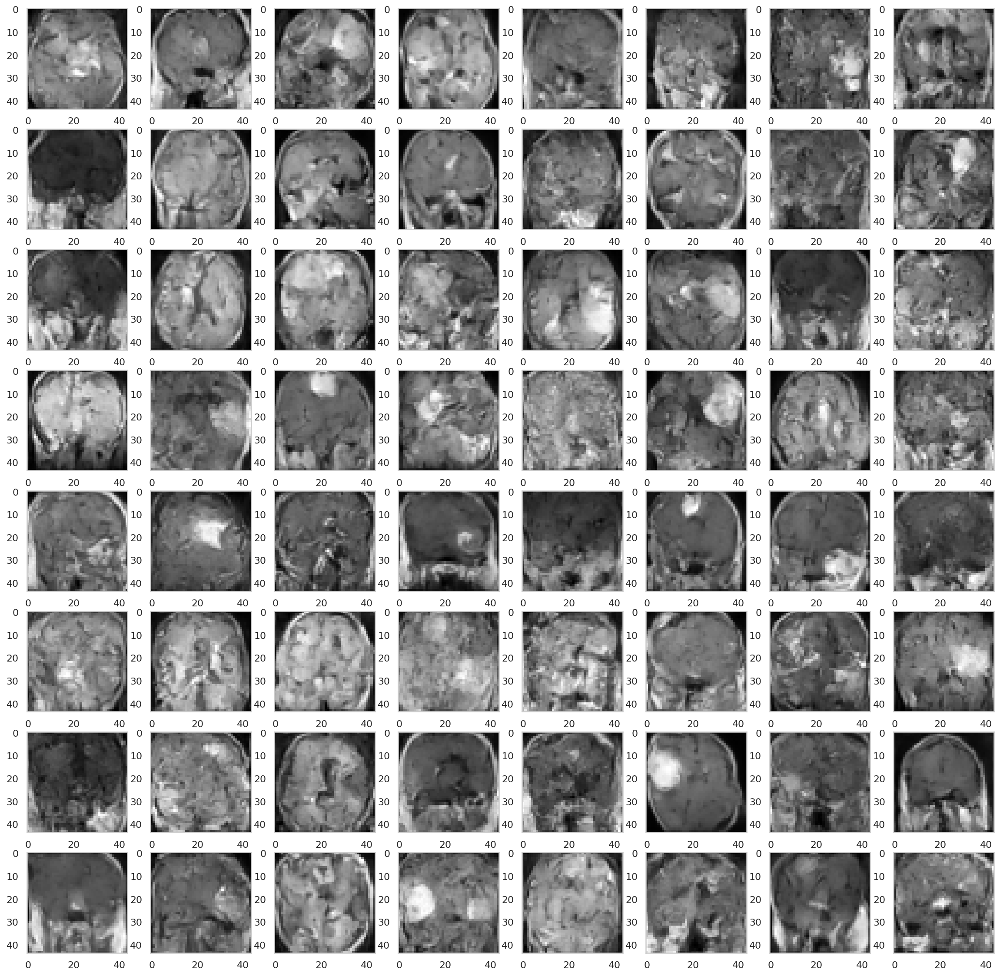

In [ ]:
epoch_plot(165)

### epoch 210

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

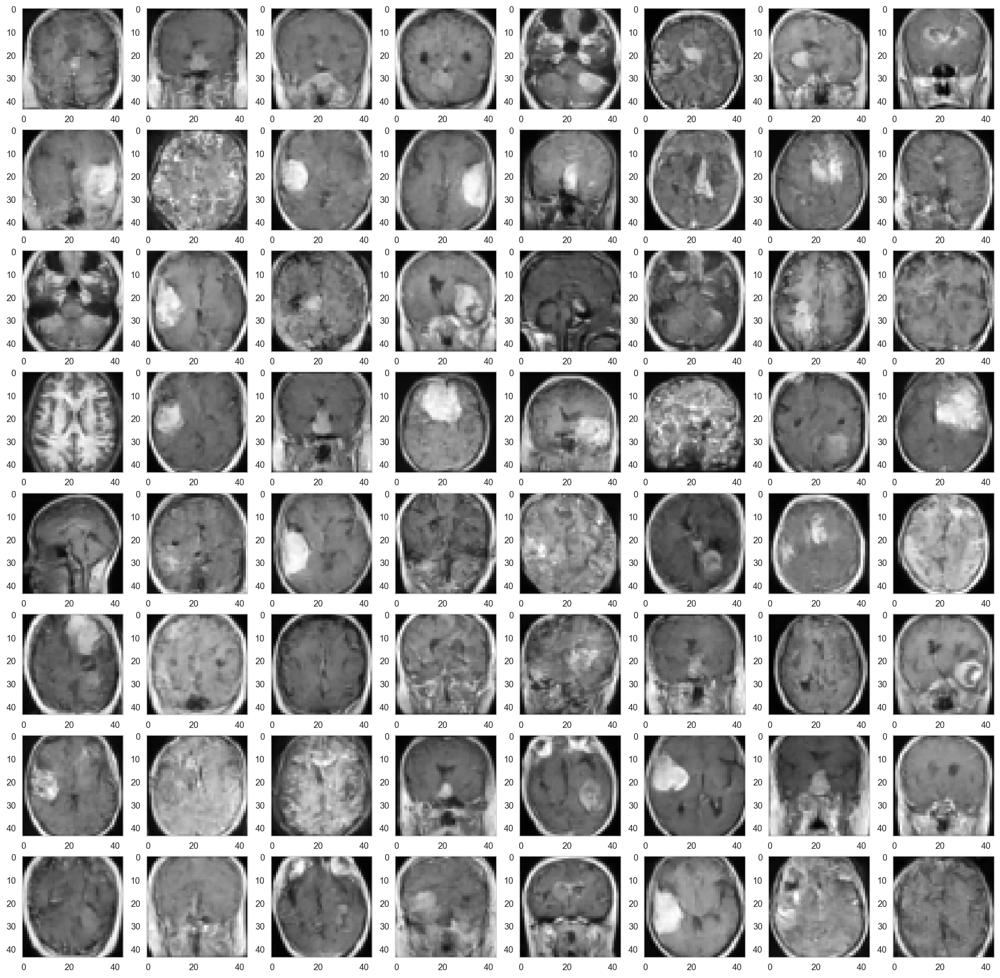

In [ ]:
epoch_plot(210)

### epoch 300

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

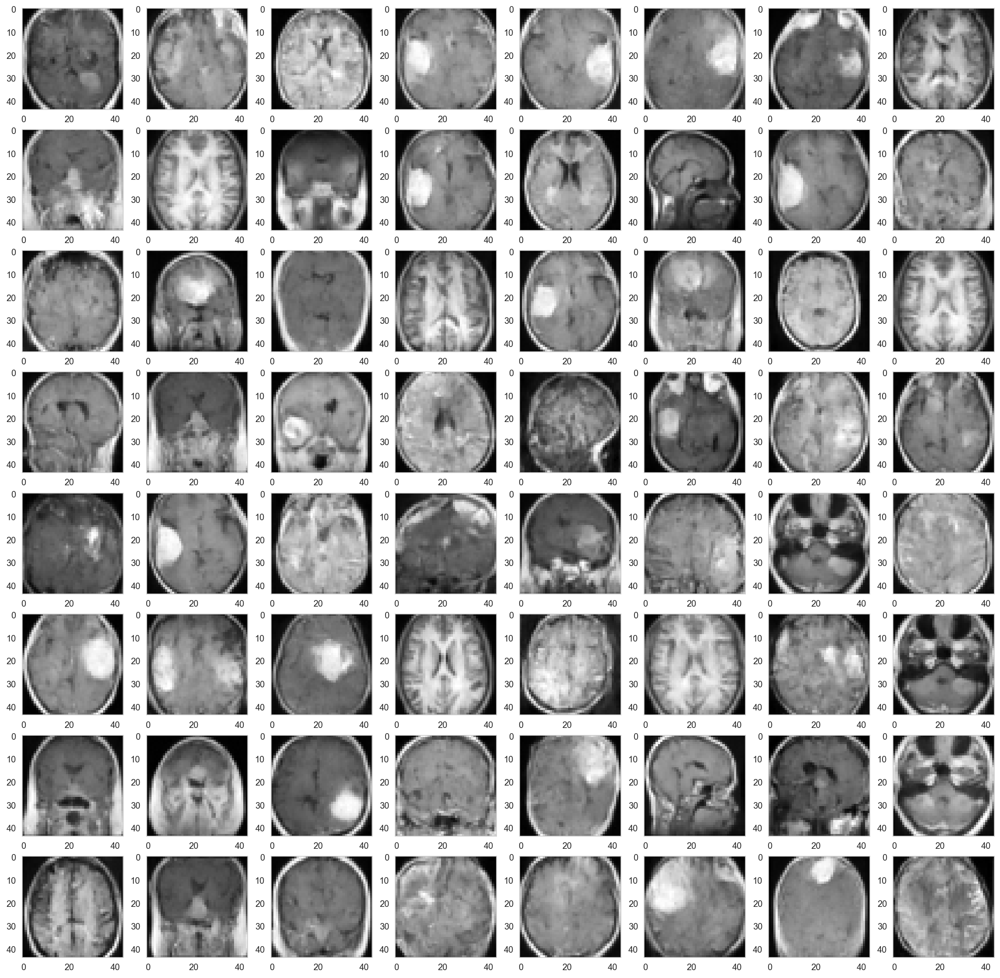

In [ ]:
epoch_plot(300)

### epoch 405

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

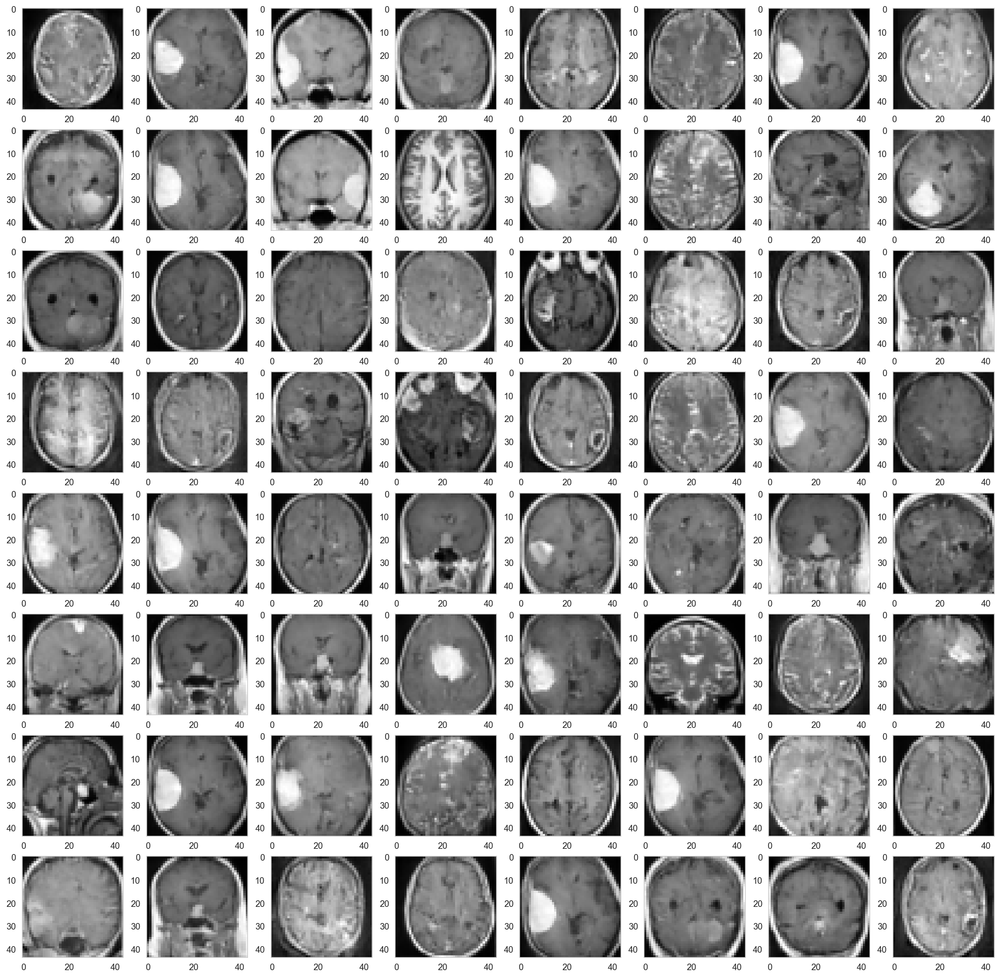

In [ ]:
epoch_plot(405)

### epoch 510

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

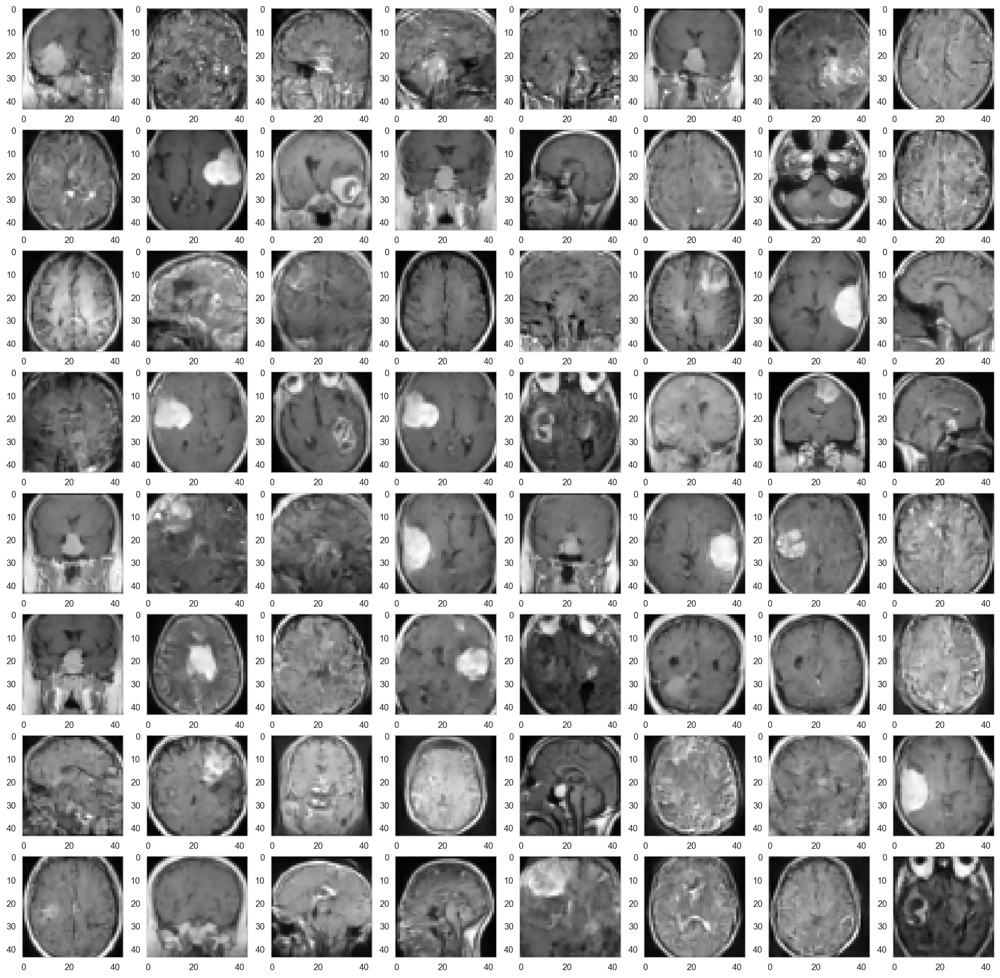

In [ ]:
epoch_plot(510)

### epoch 540

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

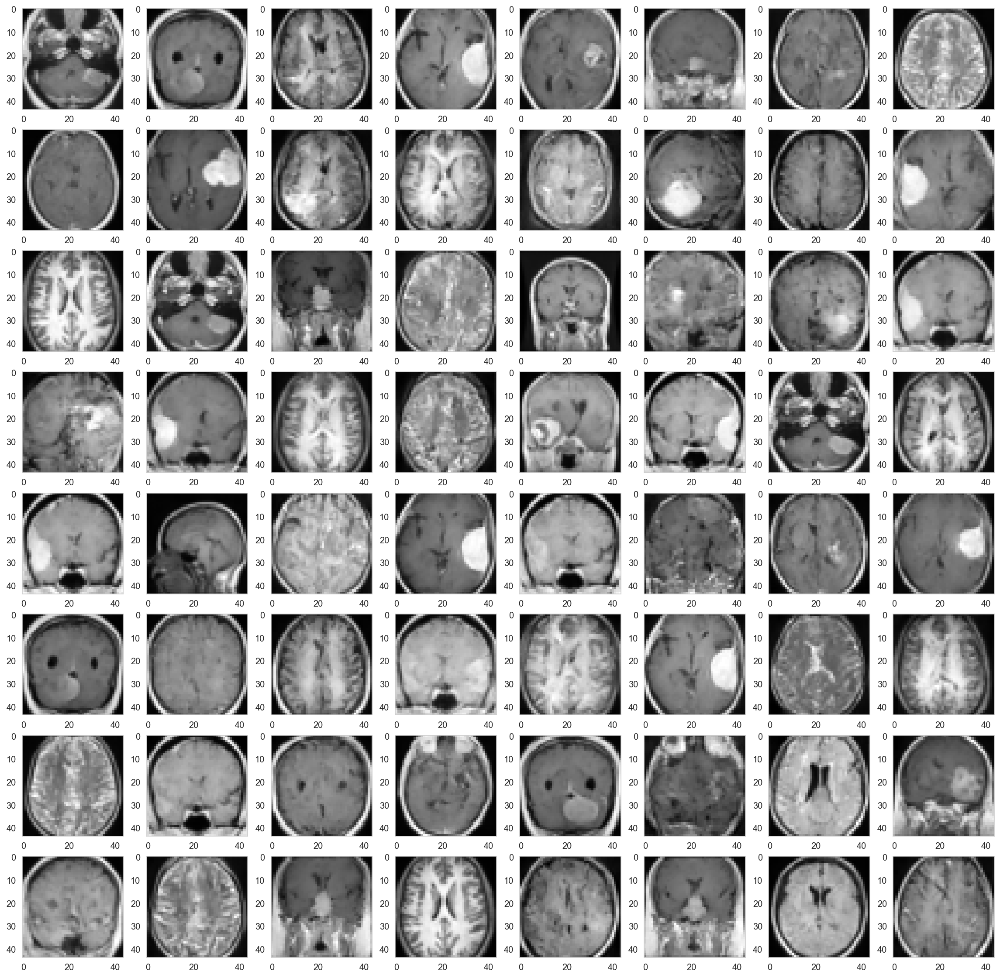

In [ ]:
epoch_plot(540)

### epoch 585 

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

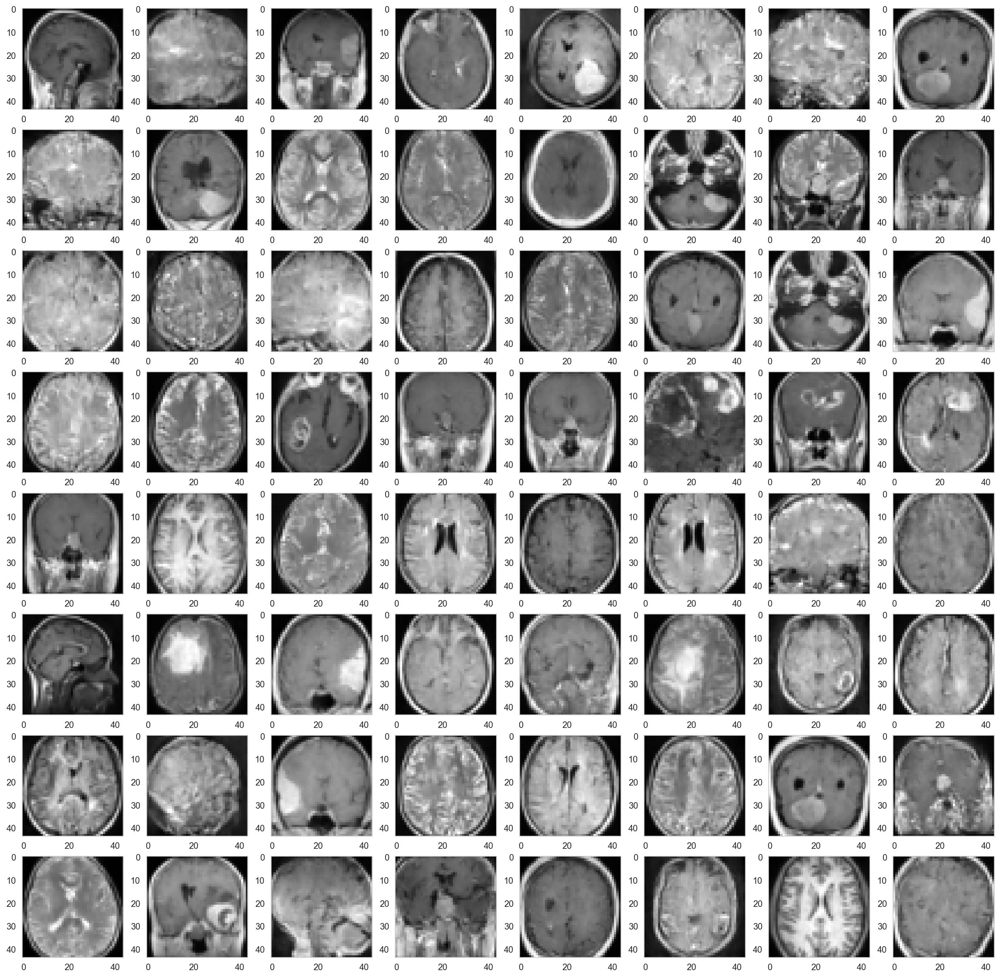

In [ ]:
epoch_plot(585)

## Improving process with higher resolution


By the instruction for our TA, I tried to train the model with 72 by 72 pixels.

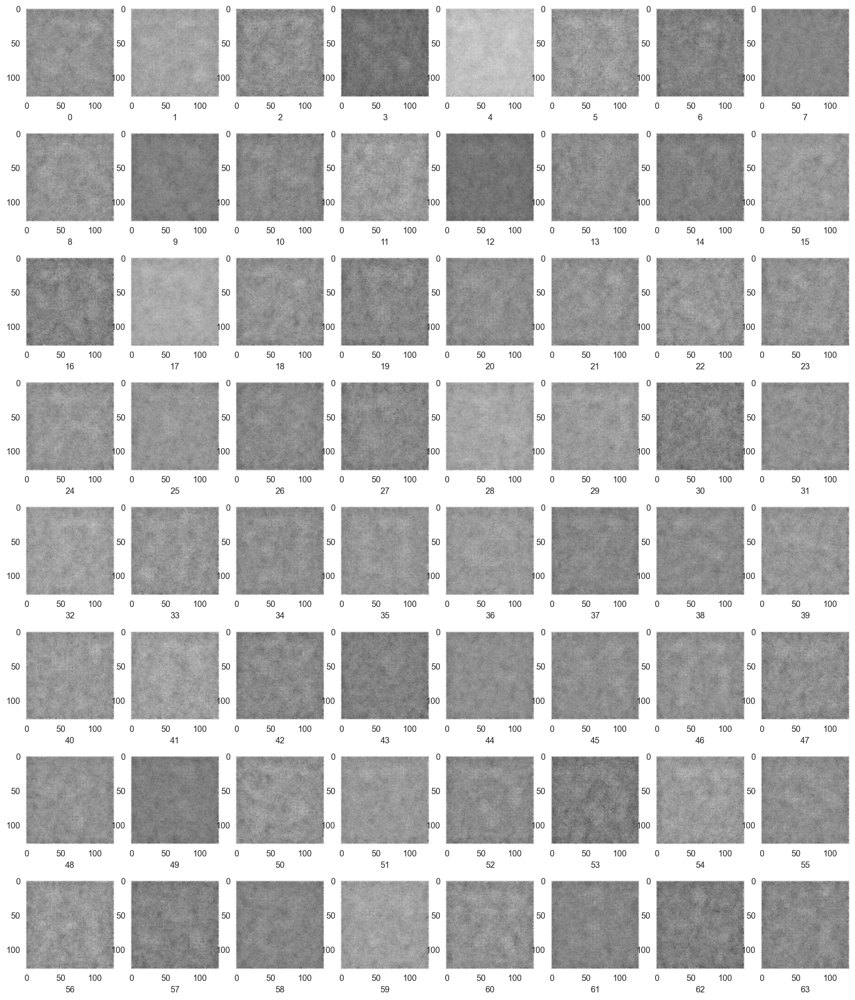

In [ ]:
fig, axs = plt.subplots(8,8,figsize = (20,20))
plt.subplots_adjust(bottom=0.1, right=0.8, top=0.9)
index = 0
for i in range(8):
  for j in range(8):
     # show a random one
    axs[i][j].imshow(samples[-1][index].reshape(image_size, image_size), cmap="gray")
    axs[i][j].set_xlabel(str(index))
    index += 1

After 100 epochs, we have this result.

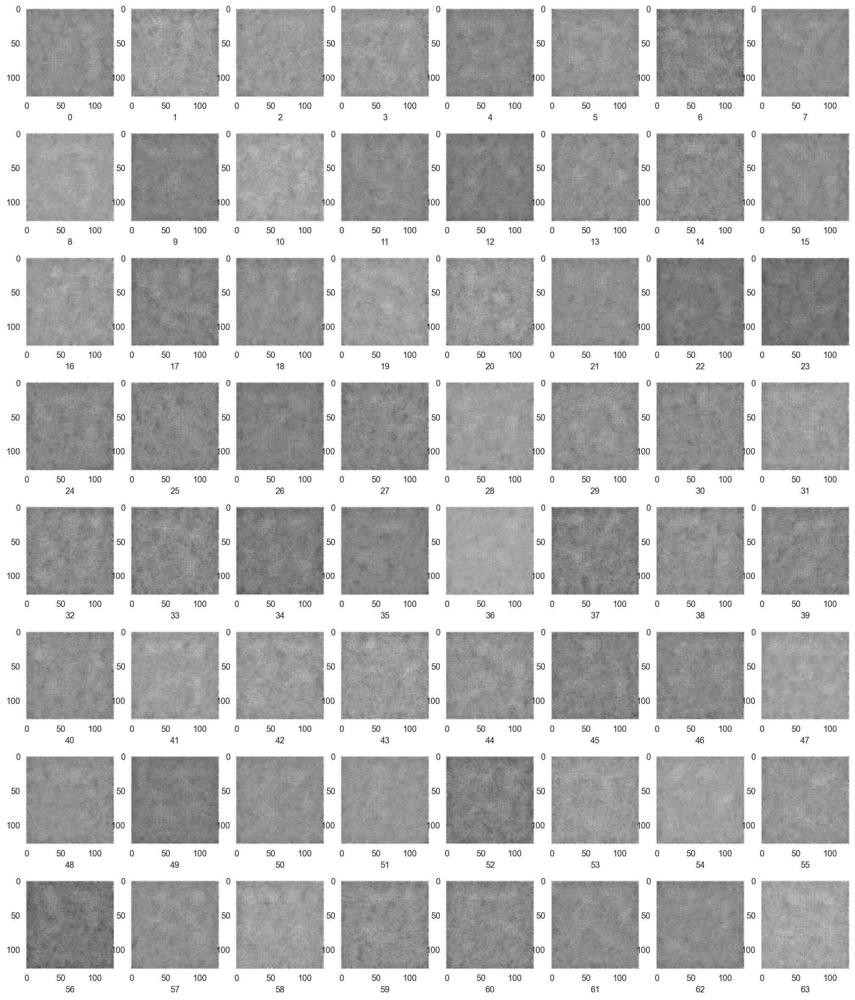

In [ ]:
fig, axs = plt.subplots(8,8,figsize = (20,20))
plt.subplots_adjust(bottom=0.1, right=0.8, top=0.9)
index = 0
for i in range(8):
  for j in range(8):
     # show a random one
    axs[i][j].imshow(samples[-1][index].reshape(image_size, image_size), cmap="gray")
    axs[i][j].set_xlabel(str(index))
    index += 1

We can see that the model can hardly learn. Since our batch size is 64, and it's too small. The model can not improve by such small batch size.

In order to get better result, we have to use a more powerful GPU to train the model.